# Plot CE0 and PL9 Families

## Imports

In [1]:
import seaborn as sns
import pandas as pd
import numpy as np

## Create data frames
incsv contains protein sequence ID and whether they are in CE0 or PL9.

infile contains the output of DIAMOND Fast. Caculation for BSR is done.

In [2]:
incsv = f"../Data/CE0_PL9/CE0_PL9_accessions.csv" 
# read in CE0 and PL9 accessions/ sequence names.
dffam = pd.read_csv(incsv) # read csv into a pandas dataframe.

In [3]:
infile = f"../Results/CE0_PL9/CE0_PL9rundiamondfast.tsv" # Set diamond input.

df = pd.read_table(infile, header=None) # Create a dataframe of Diamond input.
df.columns = ["qseqid", "sseqid", "qlen", "qstart", "qend", "pident", "bitscore"] 
# Name the columnes in the dataframe.
df["normalisedbitscore"]=df["bitscore"]/df["qlen"] 
# Caculate the normalised bitscore.
df["qcov"] = (df["qend"]-df["qstart"])/df["qlen"] # Calculate query coverage.

## Create dataframe for BSR then plot clustermap
The culstermap is plotted with a large figure size to ensure all the xtick and ytick lables can be read.

In [4]:
widedfx = pd.pivot(
    df, 
    index="qseqid", 
    columns= "sseqid", 
    values="normalisedbitscore"
) # Turn into a wide dataframe.
widedf = widedfx.fillna(0) # Remove any values NaN and replace with 0.

famqseqid = [] 
#create empty lists for the families of the query and subject sequence IDs.
famsseqid = []

for qseqid in widedf: # going through the row names in df.
    fil = dffam[dffam['genbank_accession'] == qseqid] # filter through accessions
    if len(fil) > 1:
        family = 'CE0+PL9' # identify and annotate multi-domain CAZymes
    else:
        family = fil.iloc[0]['family']
    famqseqid.append(family)
for sseqid in widedf.columns: # same as before but for columns not rows.
    fil = dffam[dffam['genbank_accession'] == sseqid]
    if len(fil) > 1:
        family = 'CE0+PL9'
    else:
        family = fil.iloc[0]['family']
    famsseqid.append(family)

widedf['Family'] = famqseqid # Add family annotations to BSR dataframe
pd_series = widedf.pop('Family')
lut = dict(zip(set(famqseqid), sns.color_palette("Set1", n_colors=len(set(famqseqid)))))
row_colours = pd_series.map(lut)

In [5]:
def plotdiamond(fast): # Function is called plotdiamond.
    """Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'. """
    sns.set(font_scale=0.5)
    figure=sns.clustermap(# Plot clustermap of the data frame created.
        widedf, 
        cmap="Blues", 
        figsize=(450, 450), 
        row_colors=row_colours, 
        col_colors=row_colours, 
        yticklabels=1, 
        xticklabels=1
    ); 
    for label in list(lut.keys()):
        figure.ax_row_dendrogram.bar(0, 0, color=lut[label], label=label, linewidth=0)
        
    l3 = figure.ax_row_dendrogram.legend(
        title='Legend', 
        loc='upper right', 
        ncol=1, 
        fontsize=400
    )
    
    figure.ax_heatmap.set_xlabel("Subject Sequence ID",fontsize=300, labelpad=15)
    figure.ax_heatmap.set_ylabel("Query Sequence ID",fontsize=300, labelpad=15)
    figure.ax_heatmap.set_title(
        f'CE0 and PL9 CAZymes Normalised Bitscore Calculated by Diamond Fast',
        fontsize=400, 
        pad=80
    )
    figure.savefig(f'../Results/CE0_PL9/CE0_PL9_BSR_hugeREAD.png') 
    # Save in results folder.
    return figure
    
plotBSR = plotdiamond('fast') # Run function for 100 sequences at fast

help(plotdiamond) # Call functions doc string to explain what the function does

/home/cjohns/.local/lib/python3.6/site-packages/seaborn/matrix.py:654: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Help on function plotdiamond in module __main__:

plotdiamond(fast)
    Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'.



## Build CSV file of the order the query and subject sequences appear in the BSR cluster map

In [6]:
columnorder = list(plotBSR.__dict__['data2d'].keys()) 
# set column order to order calculated for BSR clustermap.
roworder = list(plotBSR.__dict__['data2d'].index) 
# set row order to order calculated for BSR clustermap.

In [7]:
dfBSR = widedf[columnorder]
dfBSR = dfBSR.reindex(roworder) # reordered dataframe.

In [8]:
dfBSR.to_csv('../Results/CE0_PL9/CE0_PL9_BSR.csv') # Save results to CSV file.

## Plot of BSR a 2nd time with known order

In [9]:
famqseqid = [] 
#create empty lists for the families of the query and subject sequence IDs.
famsseqid = []

for qseqid in dfBSR: # going through the row names in df.
    fil = dffam[dffam['genbank_accession'] == qseqid] # filter through accessions
    if len(fil) > 1:
        family = 'CE0+PL9' # identify and annotate multi-domain CAZymes
    else:
        family = fil.iloc[0]['family']
    famqseqid.append(family)
for sseqid in dfBSR.columns: # going through the column names in df.
    fil = dffam[dffam['genbank_accession'] == sseqid] 
    # same as before but for columns not rows.
    if len(fil) > 1:
        family = 'CE0+PL9'
    else:
        family = fil.iloc[0]['family']
    famsseqid.append(family)

dfBSR['Family'] = famqseqid # Add family annotations to BSR dataframe
pd_series = dfBSR.pop('Family')
lut = dict(zip(set(famqseqid), sns.color_palette("Set1", n_colors=len(set(famqseqid)))))
row_colours = pd_series.map(lut)

In [10]:
def plotdiamond(fast): # Function is called plotdiamond.
    """Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'. """
    sns.set(font_scale=0.5)
    figure=sns.clustermap(
        dfBSR, 
        cmap="Blues", 
        figsize=(450, 450), 
        row_colors=row_colours, 
        col_colors=row_colours, 
        yticklabels=1, xticklabels=1, 
        row_cluster=False, 
        col_cluster=False
    ); # Plot clustermap of the data frame created.
    
    for label in list(lut.keys()):
        figure.ax_row_dendrogram.bar(0, 0, color=lut[label], label=label, linewidth=0)
        
    l3 = figure.ax_row_dendrogram.legend(
        title='Legend', 
        loc='upper right', 
        ncol=1, 
        fontsize=400
    )
    
    figure.ax_heatmap.set_xlabel("Subject Sequence ID",fontsize=300, labelpad=15)
    figure.ax_heatmap.set_ylabel("Query Sequence ID",fontsize=300, labelpad=15)
    figure.ax_heatmap.set_title(
        f'CE0 and PL9 CAZymes Normalised Bitscore Calculated by Diamond Fast',
        fontsize=400, 
        pad=80
    )
    figure.savefig(f'../Results/CE0_PL9/CE0_PL9_BSR_huge.png') # Save in results folder.
    return figure
    
plotBSR = plotdiamond('fast') # Run function for 100 sequences at fast

help(plotdiamond) # Call functions doc string to explain what the function does

Help on function plotdiamond in module __main__:

plotdiamond(fast)
    Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'.



## Find interesting proteins then sub set dataframe.
### Write out protein with both CE0 and PL9 domains to a CSV file.
### Proteins of interest are those which have a BSR > 1 in common with a protein 
### contained in both CE0 and PL9 families.

In [11]:
cooccurring = pd_series.loc[pd_series == 'CE0+PL9'] 
# write multi-domain CAZymes to a list.
cooccurring.to_csv('../Results/CE0_PL9/Cooccuring.csv') # save the list.

In [12]:
pro = ['AEI43346.1', 'AFH63317.1', 'AFK65394.1', 'QYM77803.1'] # multi-domain CAZymes list.
threshold = 1 # Set BSR threshold to 1.
interest = {'AEI43346.1', 'AFH63317.1', 'AFK65394.1', 'QYM77803.1'} 
# dictionary called interest.

In [14]:
for sseqid in pro:
    col = list(dfBSR[sseqid])
    for i in range(len(col)):
        if col[i] >= threshold:
            interest.add(dfBSR.iloc[i].name) 
            # Add any sequences in the same column as a CE0-PL9 protein with a BSR>1 to interest.
    row = list(dfBSR.loc[sseqid])
    for i in range(len(row)):
        if row[i] >= threshold:
            print(i, row[i])
            interest.add(dfBSR.columns[i]) 
            # Add any sequences in the same row as a CE0-PL9 protein with a BSR>1 to interest.

4233 2.002014098690836
4234 1.5387713997985901
4235 1.539778449144008
4233 1.9665379665379665
4234 2.0167310167310166
4235 2.0167310167310166
4233 1.9540816326530612
4234 2.0
4235 2.0191326530612246
3215 1.8465753424657534


In [15]:
dfnew = dfBSR[interest]
dfsmol2 = dfnew.loc[interest] # subset dataframe

In [16]:
famqseqid = [] #create empty lists for the families of the query and subject sequence IDs.
famsseqid = []

for qseqid in dfsmol2: # going through the row names in df.
    fil = dffam[dffam['genbank_accession'] == qseqid] # filter through accessions
    if len(fil) > 1:
        family = 'CE0+PL9' # identify and annotate multi-domain CAZymes
    else:
        family = fil.iloc[0]['family']
    famqseqid.append(family)
for sseqid in dfsmol2.columns: 
    # going through the column names in df same as before but for columns not rows.
    fil = dffam[dffam['genbank_accession'] == sseqid]
    if len(fil) > 1:
        family = 'CE0+PL9'
    else:
        family = fil.iloc[0]['family']
    famsseqid.append(family)

dfsmol2['Family'] = famqseqid # Add family annotations to BSR dataframe
pd_series = dfsmol2.pop('Family')
lut = dict(zip(set(famqseqid), sns.color_palette("Set1", n_colors=len(set(famqseqid)))))
row_colours = pd_series.map(lut)

Help on function plotdiamond in module __main__:

plotdiamond(fast)
    Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'.



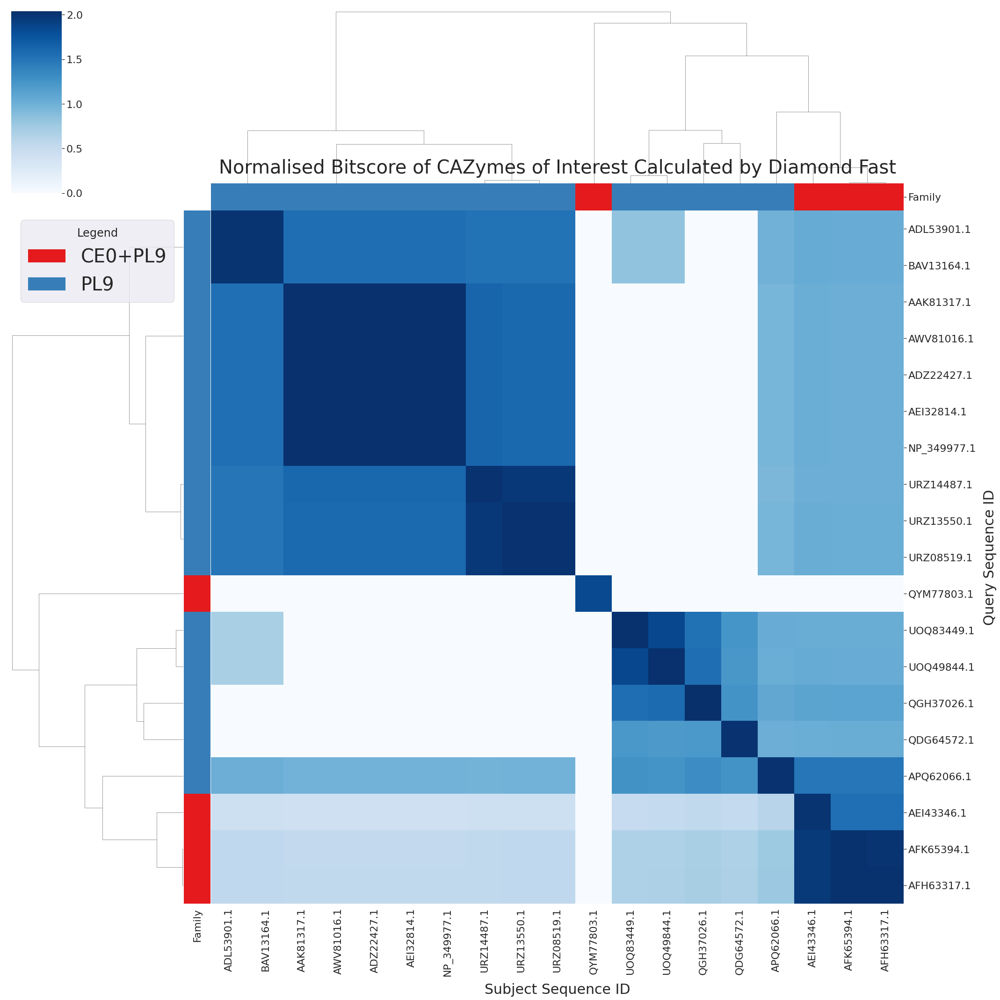

In [17]:
def plotdiamond(fast): # Function is called plotdiamond.
    """Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'. """
    sns.set(font_scale=2)
    figure=sns.clustermap(
        dfsmol2, 
        cmap="Blues", 
        figsize=(30, 30), 
        row_colors=row_colours, 
        col_colors=row_colours, 
        yticklabels=1, 
        xticklabels=1
    ); # Plot clustermap of the data frame created.
    for label in list(lut.keys()):
        figure.ax_row_dendrogram.bar(0, 0, color=lut[label], label=label, linewidth=0)
        
    l3 = figure.ax_row_dendrogram.legend(
        title='Legend', 
        loc='upper right', 
        ncol=1, 
        fontsize=40
    )

    figure.ax_heatmap.set_xlabel("Subject Sequence ID",fontsize=30, labelpad=15)
    figure.ax_heatmap.set_ylabel("Query Sequence ID",fontsize=30, labelpad=15)
    figure.ax_heatmap.set_title(
        f'Normalised Bitscore of CAZymes of Interest Calculated by Diamond Fast',
        fontsize=40, 
        pad=80
    )
    figure.savefig(f'../Results/CE0_PL9/CE0_PL9_BSRZoom.png') # Save in results folder.
    return figure
    
plotBSRZoom = plotdiamond('fast') # Run function for 100 sequences at fast

help(plotdiamond) # Call functions doc string to explain what the function does

### Get order of the zoomed in Clusterplot and print to CSV file

In [18]:
corder = list(plotBSRZoom.__dict__['data2d'].keys()) 
# Get column order from zoomed in BSR clustermap for query coverage map.
rorder = list(plotBSRZoom.__dict__['data2d'].index) # get row order.

In [19]:
dfprint = dfsmol2[corder]
dfprint = dfprint.reindex(rorder) # reorder dataframe

In [20]:
dfprint.to_csv('../Results/CE0_PL9/Zoom.csv') 
# Save copy of zoomed in dataframe to a CSV file.

## Create Dataframe for Query Cover, ensuring the sequences appear 
## in the same order as for BSR matrix and plot clustermap

In [21]:
widedfxq = pd.pivot(df, index="qseqid", columns= "sseqid", values="qcov") 
# Turn Long dataframe into a wide dataframe.
widedfq = widedfxq.fillna(0) # Remove any values NaN and replace with 0.

In [22]:
# Reordering dtaframe to be same as BSR,  and print it.
dfqcov = widedfq[columnorder]
dfqcov = dfqcov.reindex(roworder)

In [23]:
dfqcov.to_csv('../Results/CE0_PL9/CE0_PL9_qcov.csv') 
# Save a copy of query coverage matrix to a CSV file.

In [24]:
famqseqid = [] #create empty lists for the families of the query and subject sequence IDs.
famsseqid = []

for qseqid in dfqcov: # going through the row names in df.
    fil = dffam[dffam['genbank_accession'] == qseqid] # filter through accessions
    if len(fil) > 1:
        family = 'CE0+PL9' # identify and annotate multi-domain CAZymes
    else:
        family = fil.iloc[0]['family']
    famqseqid.append(family)

for sseqid in dfqcov.columns: 
    # going through the column names in df same as before but for columns not rows.
    fil = dffam[dffam['genbank_accession'] == sseqid] 
    if len(fil) > 1:
        family = 'CE0+PL9'
    else:
        family = fil.iloc[0]['family']
    famsseqid.append(family)

dfqcov['Family'] = famqseqid # Add family annotations to BSR dataframe
pd_series = dfqcov.pop('Family')
lut = dict(zip(set(famqseqid), sns.color_palette("Set1", n_colors=len(set(famqseqid)))))
row_colours = pd_series.map(lut)

In [25]:
def plotdiamond(fast): # Function is called plotdiamond.
    """Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'. """
    sns.set(font_scale=0.6)
    figure=sns.clustermap(
        dfqcov, 
        cmap="rocket_r", 
        figsize=(200, 200), 
        row_colors=row_colours, 
        col_colors=row_colours, 
        yticklabels=1, 
        xticklabels=1, 
        row_cluster=False, 
        col_cluster=False,
    ); # Plot clustermap of the data frame created.
    for label in list(lut.keys()):
        figure.ax_row_dendrogram.bar(0, 0, color=lut[label], label=label, linewidth=0)
        
    l3 = figure.ax_row_dendrogram.legend(
        title='Legend', 
        loc='upper right', 
        ncol=1, 
        fontsize=200
    )
    
    figure.ax_heatmap.set_xlabel("Subject Sequence ID",fontsize=200, labelpad=15)
    figure.ax_heatmap.set_ylabel("Query Sequence ID",fontsize=200, labelpad=15)
    figure.ax_heatmap.set_title(
        f'CE0 and PL9 CAZymes Query Cover Calculated by Diamond Fast',
        fontsize=250, 
        pad=80
    )
    figure.savefig(f'../Results/CE0_PL9/CE0_PL9_qcov.png') # Save in results folder.
    return figure
    
plotqcov = plotdiamond('fast') # Run function for 100 sequences at fast

help(plotdiamond) # Call functions doc string to explain what the function does

Help on function plotdiamond in module __main__:

plotdiamond(fast)
    Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'.



## Plot interesting Proteins for Query Cover

In [26]:
dfnewq = dfqcov[interest] 
# subset query cover data frame to only contain proteins of interest stored in the 'interest' list.
dfsmolq = dfnewq.loc[interest]

In [27]:
dforderq = dfsmolq[corder] 
# reorder dataframe based off the order of the subsetted BSR clustermap.
dfqcov = dforderq.reindex(rorder)

In [28]:
famqseqid = [] #create empty lists for the families of the query and subject sequence IDs.
famsseqid = []

for qseqid in dfsmolq: # going through the row names in df.
    fil = dffam[dffam['genbank_accession'] == qseqid] # filter through accessions
    if len(fil) > 1:
        family = 'CE0+PL9' # identify and annotate multi-domain CAZymes
    else:
        family = fil.iloc[0]['family']
    famqseqid.append(family)
for sseqid in dfsmolq.columns: 
    # going through the column names in df same as before but for columns not rows.
    fil = dffam[dffam['genbank_accession'] == sseqid]
    if len(fil) > 1:
        family = 'CE0+PL9'
    else:
        family = fil.iloc[0]['family']
    famsseqid.append(family)

dfsmolq['Family'] = famqseqid # Add family annotations to BSR dataframe
pd_series = dfsmolq.pop('Family')
lut = dict(zip(set(famqseqid), sns.color_palette("Set1", n_colors=len(set(famqseqid)))))
row_colours = pd_series.map(lut)

Help on function plotdiamond in module __main__:

plotdiamond(fast)
    Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'.



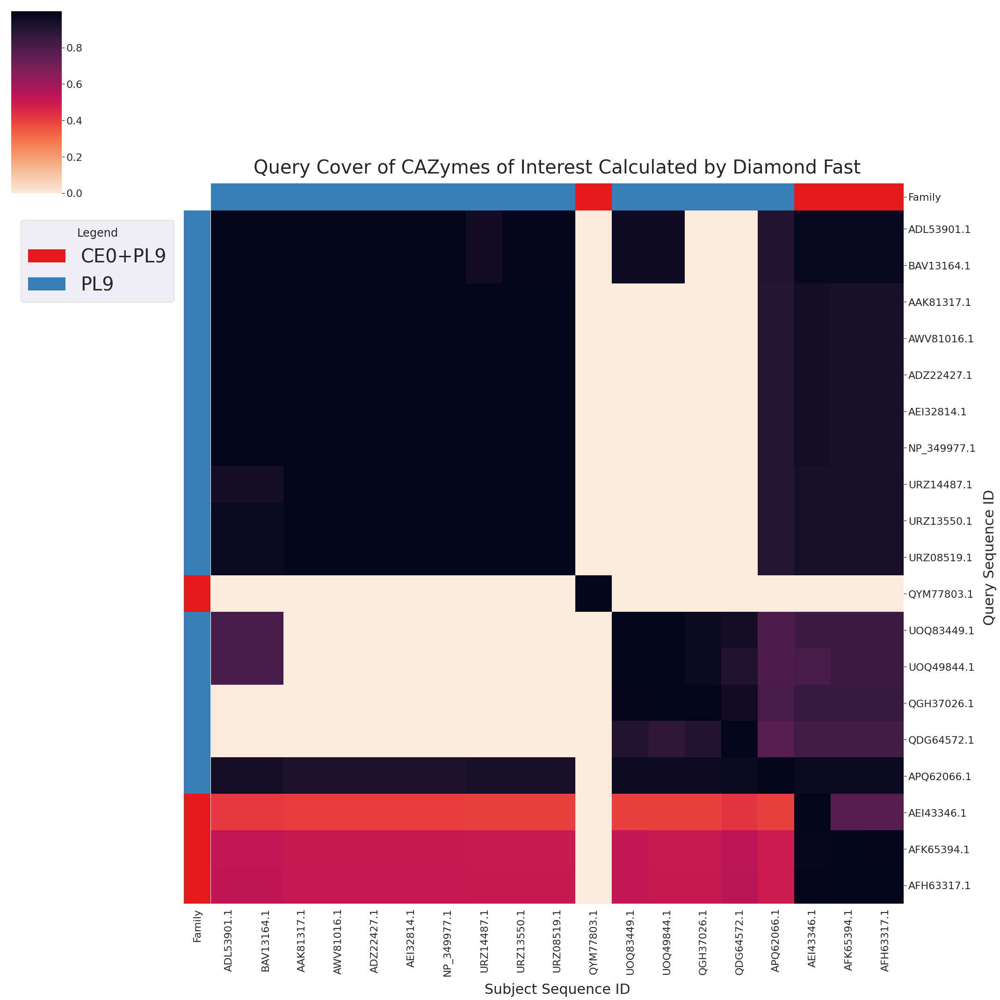

In [29]:
def plotdiamond(fast): # Function is called plotdiamond.
    """Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'. """
    sns.set(font_scale=2)
    figure=sns.clustermap(
        dfqcov, 
        cmap="rocket_r", 
        figsize=(30, 30), 
        row_colors=row_colours, 
        col_colors=row_colours, 
        yticklabels=1, 
        xticklabels=1, 
        row_cluster=False, 
        col_cluster=False
    ); # Plot clustermap of the data frame created.
    for label in list(lut.keys()):
        figure.ax_row_dendrogram.bar(0, 0, color=lut[label], label=label, linewidth=0)
        
    l3 = figure.ax_row_dendrogram.legend(
        title='Legend', 
        loc='upper right', 
        ncol=1, 
        fontsize=40
    )

    figure.ax_heatmap.set_xlabel("Subject Sequence ID",fontsize=30, labelpad=15)
    figure.ax_heatmap.set_ylabel("Query Sequence ID",fontsize=30, labelpad=15)
    figure.ax_heatmap.set_title(
        f'Query Cover of CAZymes of Interest Calculated by Diamond Fast',
        fontsize=40, 
        pad=80
    )
    figure.savefig(f'../Results/CE0_PL9/CE0_PL9_QcovZoom.png') # Save in results folder.
    return figure
    
plotBSRZoom = plotdiamond('fast') # Run function for 100 sequences at fast

help(plotdiamond) # Call functions doc string to explain what the function does

## Create Dataframe for percentage identity, ensuring the sequences 
## appear in the same order as BSR and plot clustrmap

In [30]:
widedfxi = pd.pivot(df, index="qseqid", columns= "sseqid", values="pident") 
# Turn Long dataframe into a wide dataframe.
widedfi = widedfxi.fillna(0) # Remove any values NaN and replace with 0.

In [31]:
# Reordering dtaframe to be same as BSR.
dfpident = widedfi[columnorder]
dfpident= dfpident.reindex(roworder)

In [32]:
famqseqid = [] #create empty lists for the families of the query and subject sequence IDs.
famsseqid = []

for qseqid in dfpident: # going through the row names in df.
    fil = dffam[dffam['genbank_accession'] == qseqid] # filter through accessions
    if len(fil) > 1:
        family = 'CE0+PL9' # identify and annotate multi-domain CAZymes
    else:
        family = fil.iloc[0]['family']
    famqseqid.append(family)

for sseqid in dfpident.columns: 
    # going through the column names in df same as before but for columns not rows.
    fil = dffam[dffam['genbank_accession'] == sseqid]
    if len(fil) > 1:
        family = 'CE0+PL9'
    else:
        family = fil.iloc[0]['family']
    famsseqid.append(family)

dfpident['Family'] = famqseqid # Add family annotations to BSR dataframe
pd_series = dfpident.pop('Family')
lut = dict(zip(set(famqseqid), sns.color_palette("Set1", n_colors=len(set(famqseqid)))))
row_colours = pd_series.map(lut)

In [33]:
def plotdiamond(fast): # Function is called plotdiamond.
    """Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'. """
    sns.set(font_scale=0.6)
    figure=sns.clustermap(
        dfpident, 
        cmap="Purples", 
        figsize=(200, 200), 
        row_colors=row_colours, 
        col_colors=row_colours, 
        yticklabels=1, 
        xticklabels=1, 
        row_cluster=False, 
        col_cluster=False
    ); # Plot clustermap of the data frame created.
    for label in list(lut.keys()):
        figure.ax_row_dendrogram.bar(0, 0, color=lut[label], label=label, linewidth=0)
        
    l3 = figure.ax_row_dendrogram.legend(
        title='Legend', 
        loc='upper right', 
        ncol=1, 
        fontsize=200
    )
    
    figure.ax_heatmap.set_xlabel("Subject Sequence ID",fontsize=200, labelpad=15)
    figure.ax_heatmap.set_ylabel("Query Sequence ID",fontsize=200, labelpad=15)
    figure.ax_heatmap.set_title(
        f'CE0 and PL9 CAZymes Percentage Identity Calculated by Diamond Fast',
        fontsize=250, 
        pad=80
    )
    figure.savefig(f'../Results/CE0_PL9/CE0_PL9_pident.png') # Save in results folder.
    return figure
    
plotqcov = plotdiamond('fast') # Run function for 100 sequences at fast

help(plotdiamond) # Call functions doc string to explain what the function does

Help on function plotdiamond in module __main__:

plotdiamond(fast)
    Function takes the output matrix calculated by diamond and plots a clustermap with 
    the argument as DIAMOND sensitvity, eg) 'Fast'.

